<a href="https://colab.research.google.com/github/tinytiny911/4630/blob/master/facerecognition_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [24]:
# Install dlib library 
!pip install dlib
!pip3 install face_recognition

In [25]:
# import image from google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [26]:
# import your passport image
!mkdir -p paspor_image
!cd paspor_image; wget -nc https://raw.githubusercontent.com/tinytiny911/4630/master/selfie.jpg

File ‘selfie.jpg’ already there; not retrieving.



In [0]:
import face_recognition
import matplotlib.pyplot as plt
import cv2
import numpy as np
from PIL import Image, ImageDraw
%matplotlib inline

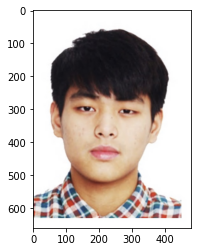

In [28]:
# show passport image
paspor_image='paspor_image/selfie.jpg'
image=cv2.imread(paspor_image)
show_img=cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(show_img)
plt.show()

In [0]:
# encodeing the passport image
selfie_image = face_recognition.load_image_file("paspor_image/selfie.jpg")
selfie_face_encoding = face_recognition.face_encodings(selfie_image)[0]

In [30]:
# import the whole face database from google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [31]:
%cd /content/drive/My Drive/faces

/content/drive/My Drive/faces


In [0]:
path='/content/drive/My Drive/faces'

In [0]:
import os

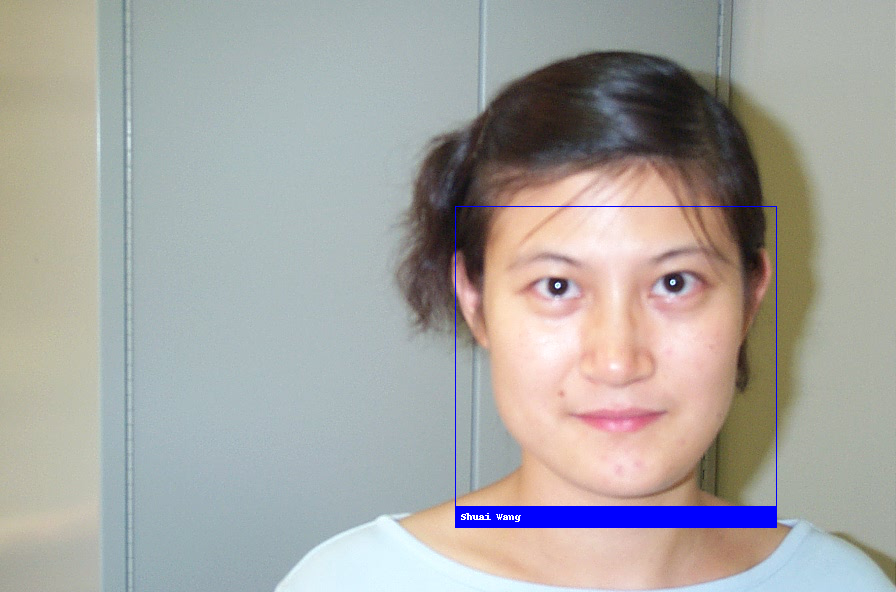

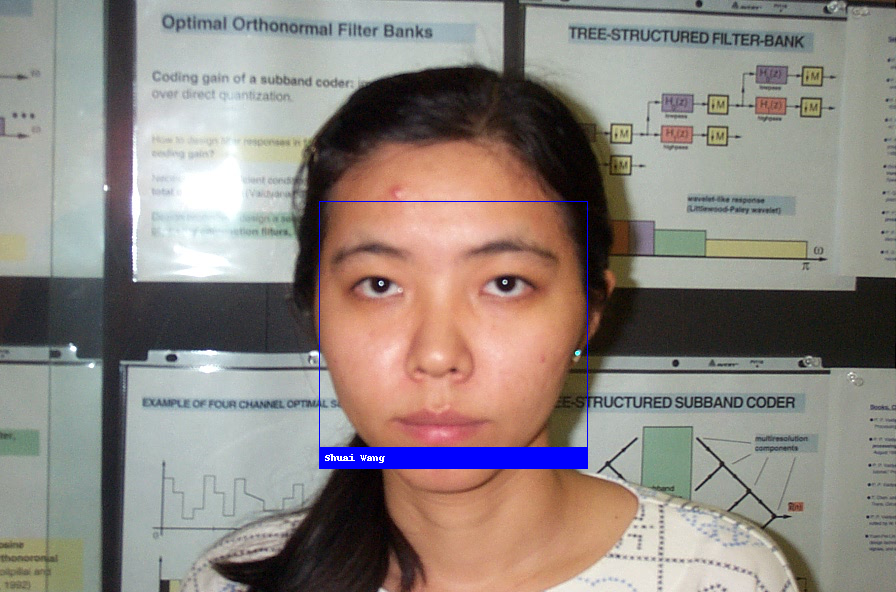

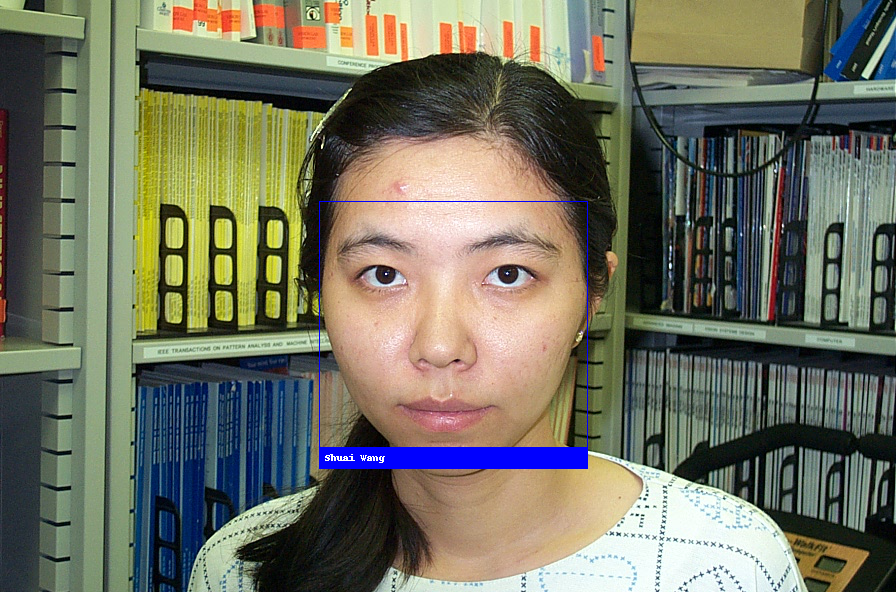

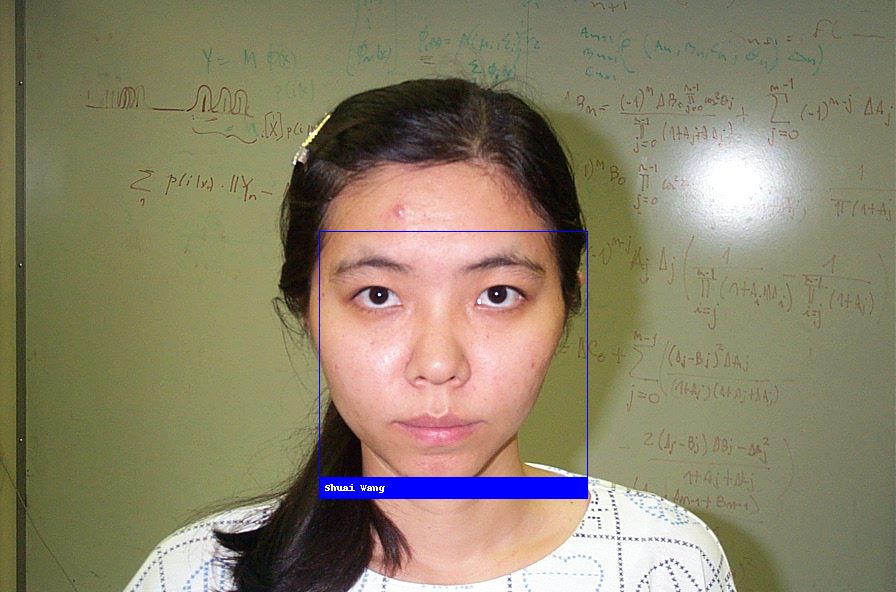

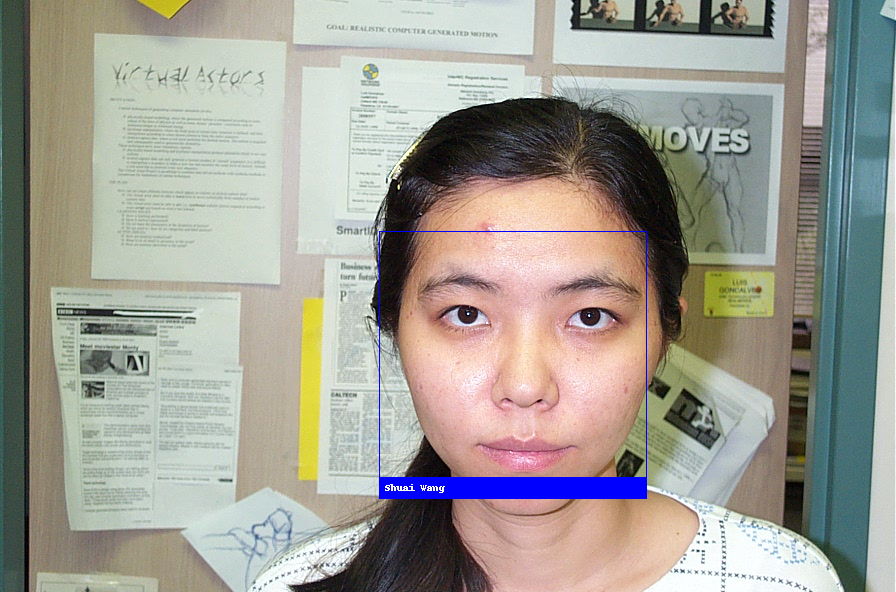

...

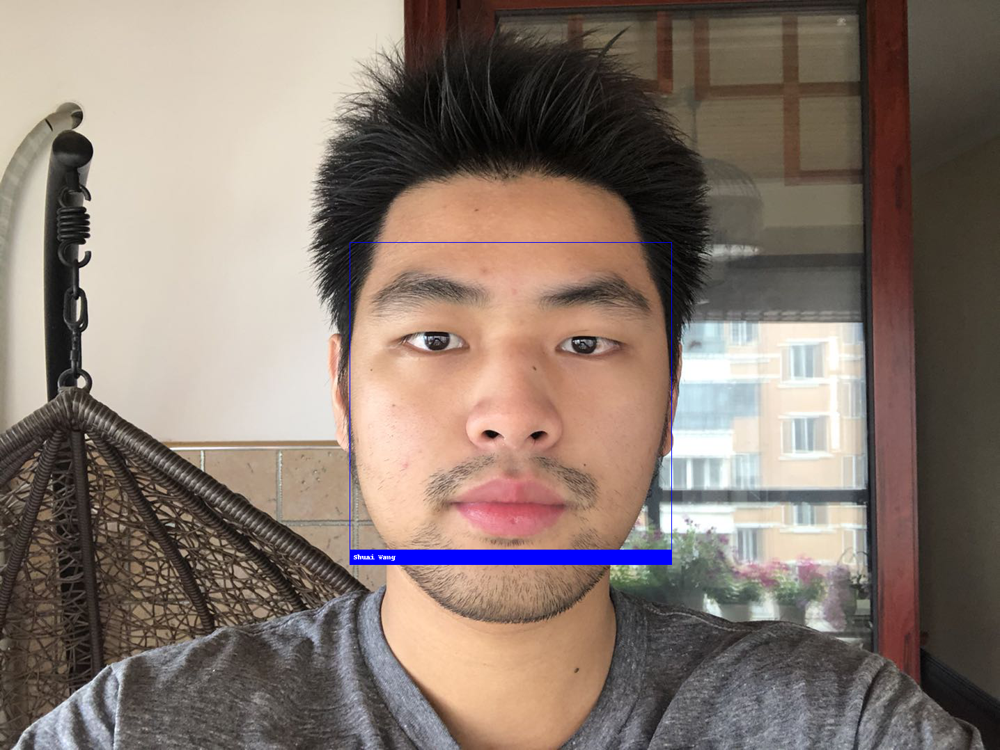

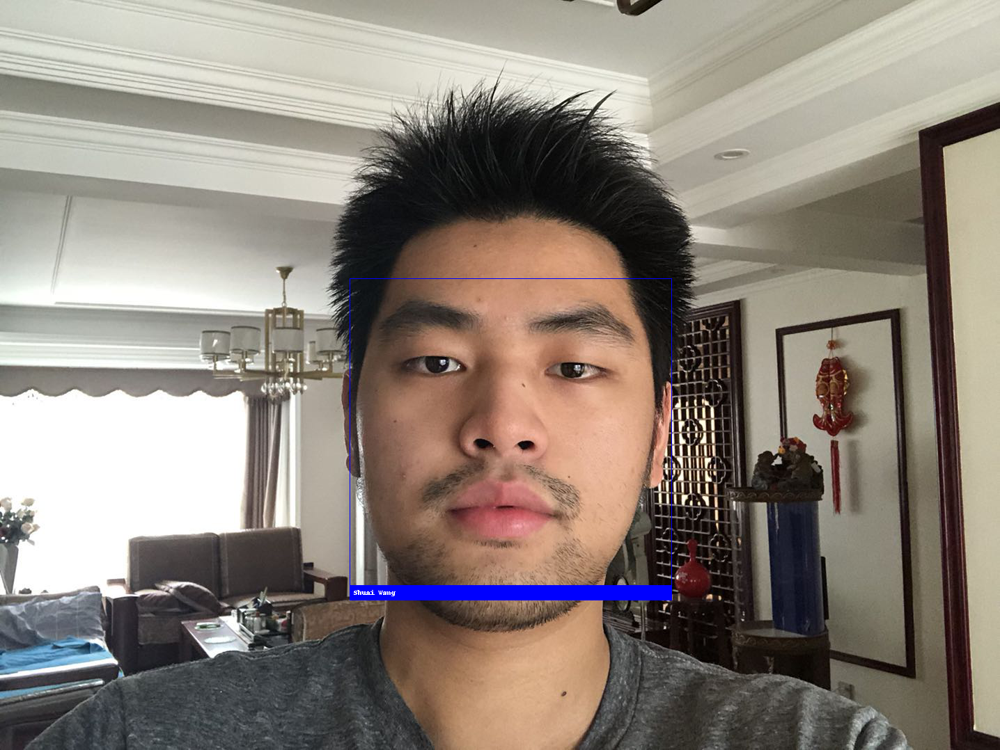

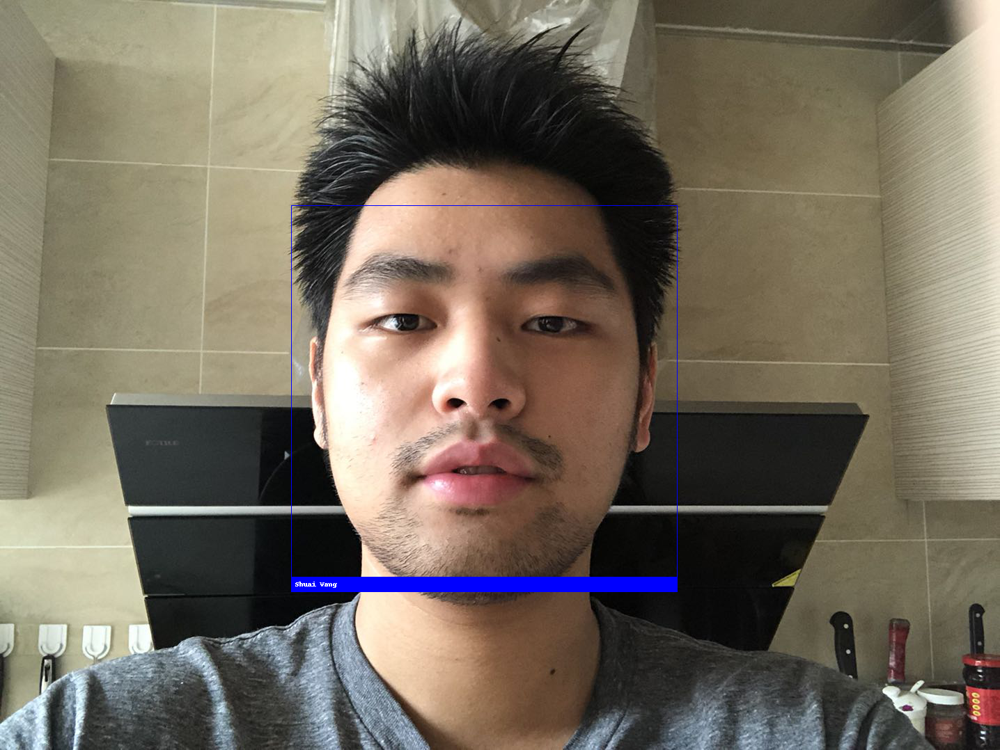

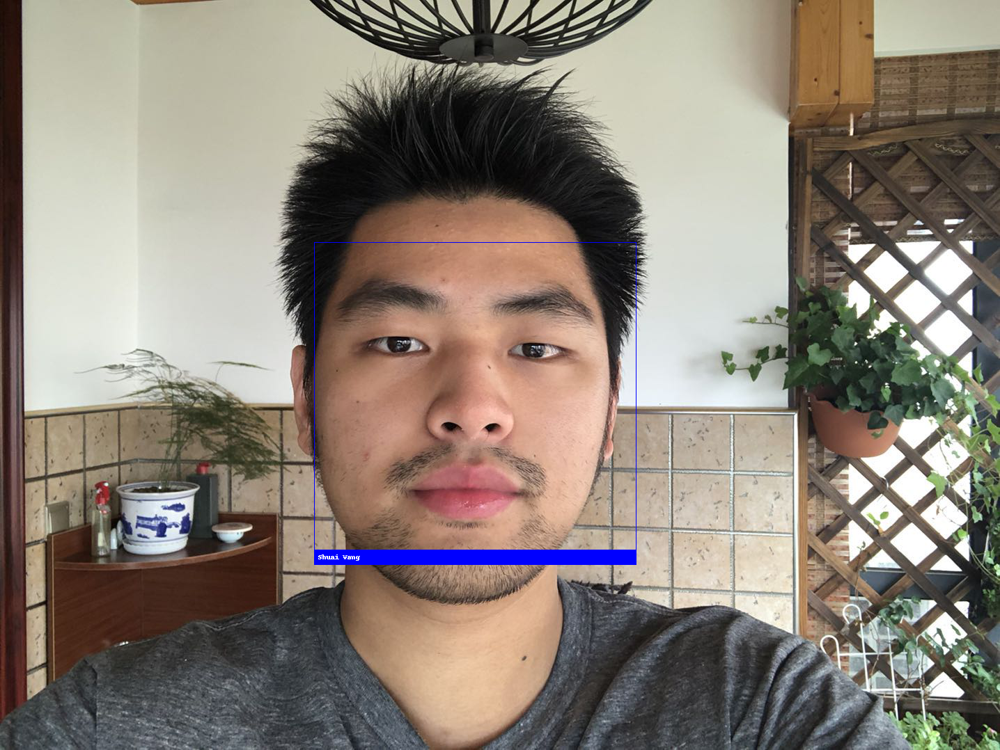

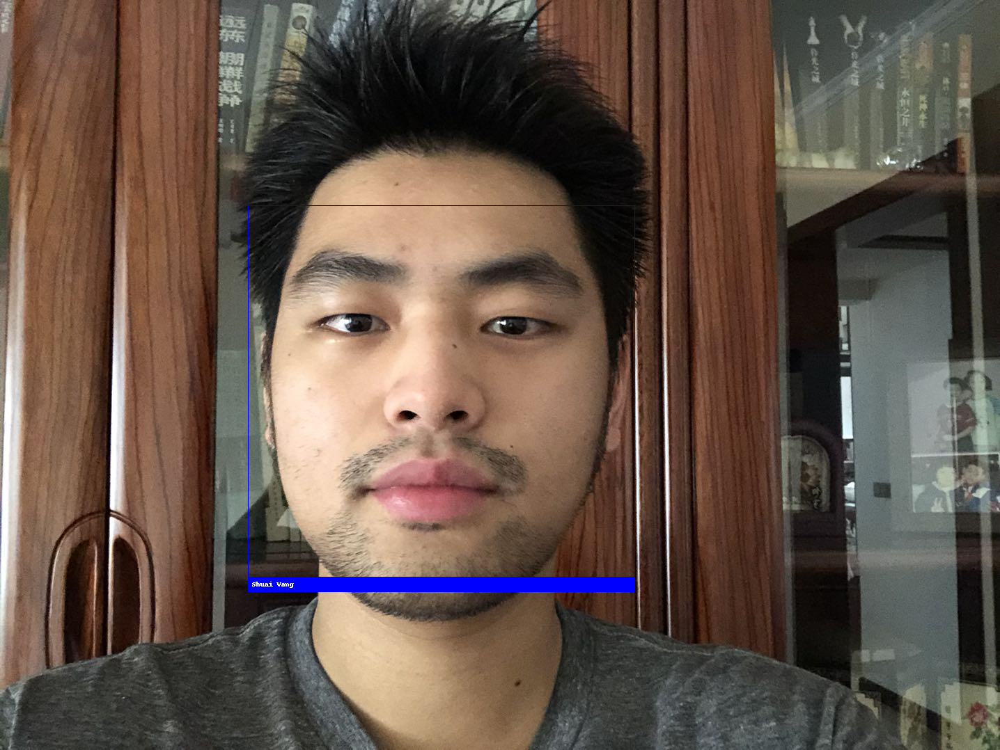

In [34]:
# traverse all the images in CalTechfaces
def geturlPath():
    path = r'../faces/'
    dirs = os.listdir(path)
    for dir in dirs:
        pa = path+dir
        # check whether it is am image or not
        if not os.path.isdir(pa):
            # output image
            yield pa
if __name__ == '__main__':
    for test_image in geturlPath():
       #test_image=cv2.imread(test_image)
       #show_img=cv2.cvtColor(re_image, cv2.COLOR_BGR2RGB)
       #plt.imshow(show_img)
       #plt.show()
       #print(test_image)

       # encoding random test faces
       random_image = face_recognition.load_image_file(test_image)
       locations = face_recognition.face_locations(random_image)
       encodings = face_recognition.face_encodings(random_image,locations)

       # Loop through each face found in the unknown image
       for (top, right, bottom, left), rand_face_encoding in zip(locations,encodings):
         # See if the face is a match for the known face(s)
         matches = face_recognition.compare_faces([selfie_face_encoding], rand_face_encoding)

         distance = face_recognition.face_distance([selfie_face_encoding], rand_face_encoding)
         best_match_index = np.argmin(distance)
         if matches[best_match_index]:
           name="Shuai Wang"
           #image=cv2.imread(test_image)
           #show_img=cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
           #plt.imshow(show_img)
           #plt.show()

           # Convert the image to a PIL-format image so that we can draw on top of it with the Pillow library
           # Create a Pillow ImageDraw Draw instance to draw with
           pil_image = Image.fromarray(random_image)
           draw = ImageDraw.Draw(pil_image)

           # Draw a box around the face using the Pillow module
           draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))
           # Draw a label with a name below the face
           text_width, text_height = draw.textsize(name)
           draw.rectangle(((left, bottom - text_height - 10), (right, bottom)), fill=(0, 0, 255), outline=(0, 0, 255))
           draw.text((left + 6, bottom - text_height - 5), name, fill=(255, 255, 255, 255))  
           # Remove the drawing library from memory as per the Pillow docs
           del draw
           display(pil_image)

plot ROC curve